## Making Card Meanings! ##
Combining data from existing Tarot Card decks, I'm trying to make names and meanings for my Oracle Cards.

(Instructor/Guidance: Allison Parrish, Coding Help: Kevin Yeh)

In [60]:
## First of all, let's organize the texts I am using

dir = './card_descriptions/'
gdritter = dir + 'git.gdritter.com.txt' ##Tarot JSON text I got from git.gdritter
Allison_text = dir + 'Interpretations_from_Allison.txt' ## Tarot JSON text from Allison
feelings_text = dir + 'feelings_list.txt' ##List of feelings gotten from the internet...

In [61]:
import json
import random

In [62]:
## Can't make sense of data in a block of text so let's make a prettyprint function function

def pp(data):
    print(json.dumps(data, indent=4))
    
## Making the structure for my new JSON that will be made eventually

new_data = {
    'meaning_light': [],
    'meaning_shadow': [],
    'keywords': [],
    'name': []
}


## First of all, let's make the card names! ##
I experimented with using nouns and objects (like animal names), but because my card imagery is generated with Machine Learning, it seems better to use abstract names. So here I used a list of feelings and created 100 random names from it. 

In [63]:
## making names via combining two lists

txt = open(feelings_text,"r") 
temp = txt.read().splitlines()
txt.close() 

## Using random.sample so I don't get duplicates

random_list = random.sample(temp, 100)

for a in random_list:
    temp_list  = "The " + a
    new_data['name'].append(temp_list)

txt.close() 

In [64]:
# Let's preview the names generated #

pp(new_data['name'])

[
    "The Distant",
    "The Rejuvenated",
    "The Flowing",
    "The Fulfilled",
    "The Dull",
    "The Resentful",
    "The Invigorated",
    "The Isolated",
    "The Weary",
    "The Awe",
    "The Uneasy",
    "The Longing",
    "The Unhappy",
    "The Concerned",
    "The Radiant",
    "The Listless",
    "The Exploring",
    "The Knotted",
    "The Afraid",
    "The Frustrated",
    "The Sorry",
    "The Present",
    "The Weak",
    "The Lonely",
    "The Disturbed",
    "The Fluttery",
    "The Drained",
    "The Irritated",
    "The Heavy",
    "The Grouchy",
    "The Disdain",
    "The Clenched",
    "The Hesitant",
    "The Electric",
    "The Aggravated",
    "The Adventurous",
    "The Shame",
    "The Tender",
    "The Furious",
    "The Shaken",
    "The Excited",
    "The Shut Down",
    "The Disappointed",
    "The Reflective",
    "The Apprehensive",
    "The Proud",
    "The Itchy",
    "The Trembly",
    "The Anxious",
    "The Interested",
    "The Withdrawn",


## Second: Parsing Tarot Card Meanings##

Let's get the text from the two JSON tarot card meanings and grab what we want from it.

In [65]:
## Getting Data from first text

with open(gdritter) as f:
    data = json.loads(f.read())
    
    for (card_name, card_info) in data.items():
        
        ## using split to get individual strings for the meanings
        
        meaning_lgt = card_info['Range of Meaning']["Light"].replace('"', '').split('.')
        
        ## Using list comprehesion because I get random empty strings otherwise...
        
        meaning_lgt_fmt = [i.strip() for i in meaning_lgt if i != '']
        
        meaning_shdw = card_info['Range of Meaning']['Shadow'].replace('"', '').split('.')
        meaning_shdw_fmt = [i.strip() for i in meaning_shdw if i != '']
        
        keywords = card_info['Keywords'][0].split(', ')
        
        
        ## adding the new values to the new json keys
        
        new_data['meaning_light'] += meaning_lgt_fmt
        new_data['meaning_shadow'] += meaning_shdw_fmt
        new_data["keywords"] += keywords
            
#     pp(new_data)


In [66]:
## Getting Data from second text
    
with open(Allison_text) as f:
    data = json.loads(f.read())
  
    ## pp(data['tarot_interpretations'])
    
    for i in data['tarot_interpretations']:
        
        keywords = i['keywords']
        
        meaning_lgt = i['meanings']['light']
        meaning_lgt = [a.replace('"', '') for a in meaning_lgt]
        
        meaning_shdw = i['meanings']['shadow']
        meaning_shdw = [a.replace('"', '') for a in meaning_shdw]
        
        ## adding the new values to the new json keys
        
        new_data['meaning_light'] += meaning_lgt
        new_data['meaning_shadow'] += meaning_shdw
        new_data["keywords"] += keywords
            

## Finally, save the new JSON! ##

In [67]:
## Writing the compiled text to new JSON file

file = open("./card_descriptions/combined_card_readings.txt", "w")
file.write(json.dumps(new_data))
file.close()

In [68]:
## Proofreading the new JSON file

pp(new_data)

{
    "meaning_light": [
        "Charging ahead",
        "Making rapid progress",
        "Refusing limits",
        "Dazzling those around you with your wit and charm",
        "Convincing others of your right to leadership",
        "Convincing others to follow you",
        "Being a catalyst for change",
        "Giving time, money, or effort to a charity",
        "Taking part in a group effort",
        "Lending your resources to others without expecting anything in return",
        "Making sure everyone is treated equally",
        "Working together toward a common goal",
        "Redistributing wealth, time, or attention",
        "Tithing",
        "Sharing credit for your success",
        "Acknowledging loss and moving on",
        "Focusing on how the glass remains half-full",
        "Finding the silver lining in a dark cloud",
        "Recognizing that loss is a natural part of life",
        "Embracing healthy grief",
        "Learning lessons from harsh consequences",


## Let's Pick the Card Images! ##

Picking a random image from a batch of ML-generated cards

In [69]:
from PIL import Image
from IPython.display import display
import random, os

path = r"./result_images/Fourth_training/Generated_Images/"
rand_images = random.sample(os.listdir(path), 22)
# print(rand_images)

## This is to preview images
# disp_image=Image.open(path+'/'+ rand_images)
# display(disp_image)

## Let's Practice Generating New Cards ##

From the new JSON!

Name: The Calm
Keyword: ['dissatisfaction', 'release', 'objectivity']
Light: Changing the way you see the world
Shadow: Refusing offers of support

img000000096.jpg


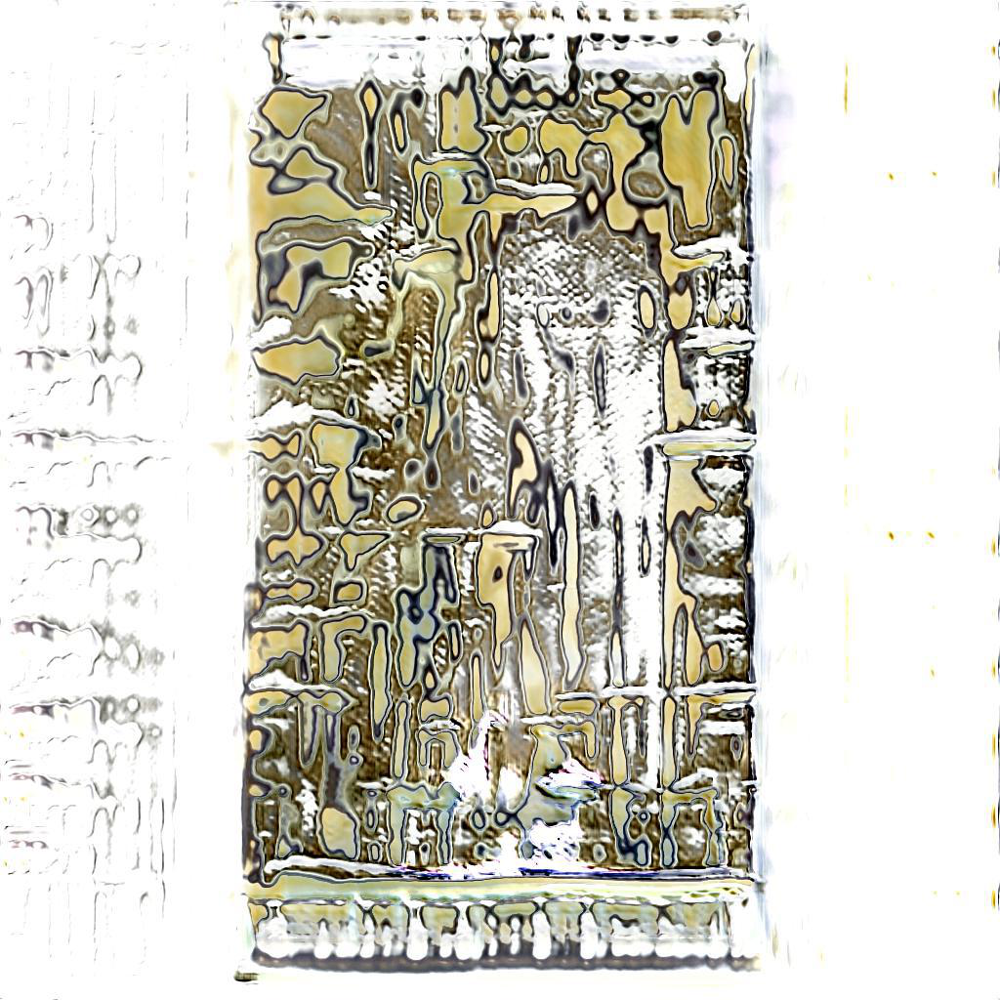

Name: The Worthy
Keyword: ['vitality', 'Loss', 'success']
Light: Judging your own performance with kindness and gentleness
Shadow: Taking on more work than you know you can handle

img000000075.jpg


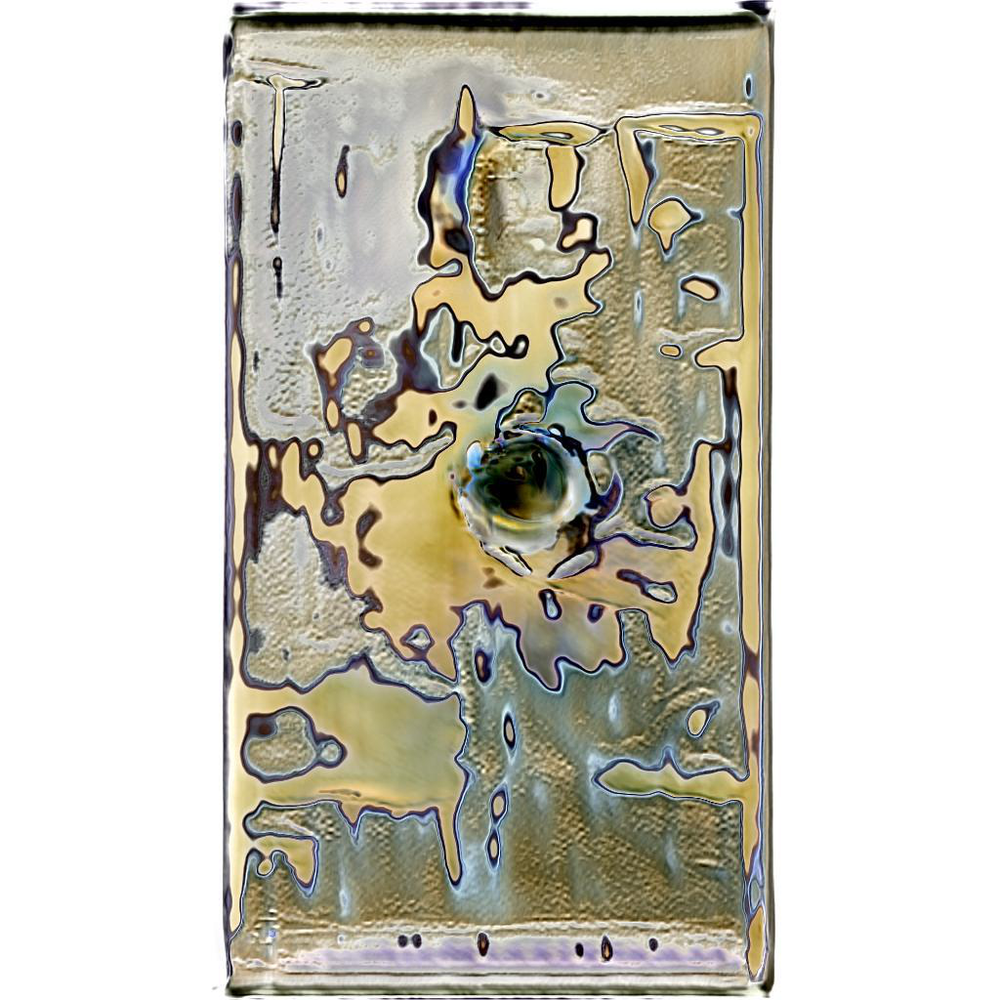

Name: The Knotted
Keyword: ['truth', 'stamina', 'destitution']
Light: Using visualization to encourage progress
Shadow: Giving or receiving insincere praise

img000000098.jpg


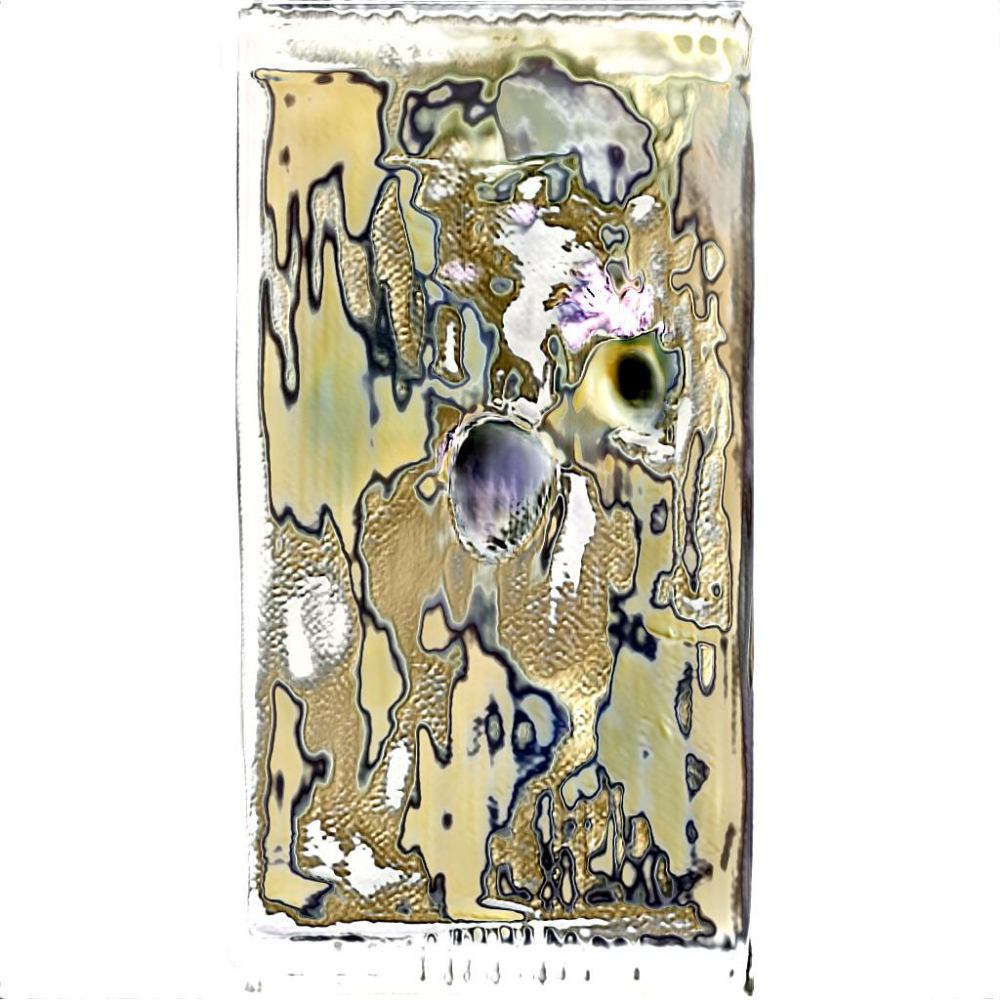

Name: The Dull
Keyword: ['activity', 'achievement', 'self-discipline']
Light: Comparing progress made so far to standards set earlier
Shadow: Refusing to become involved, even when involvement is appropriate

img000000067.jpg


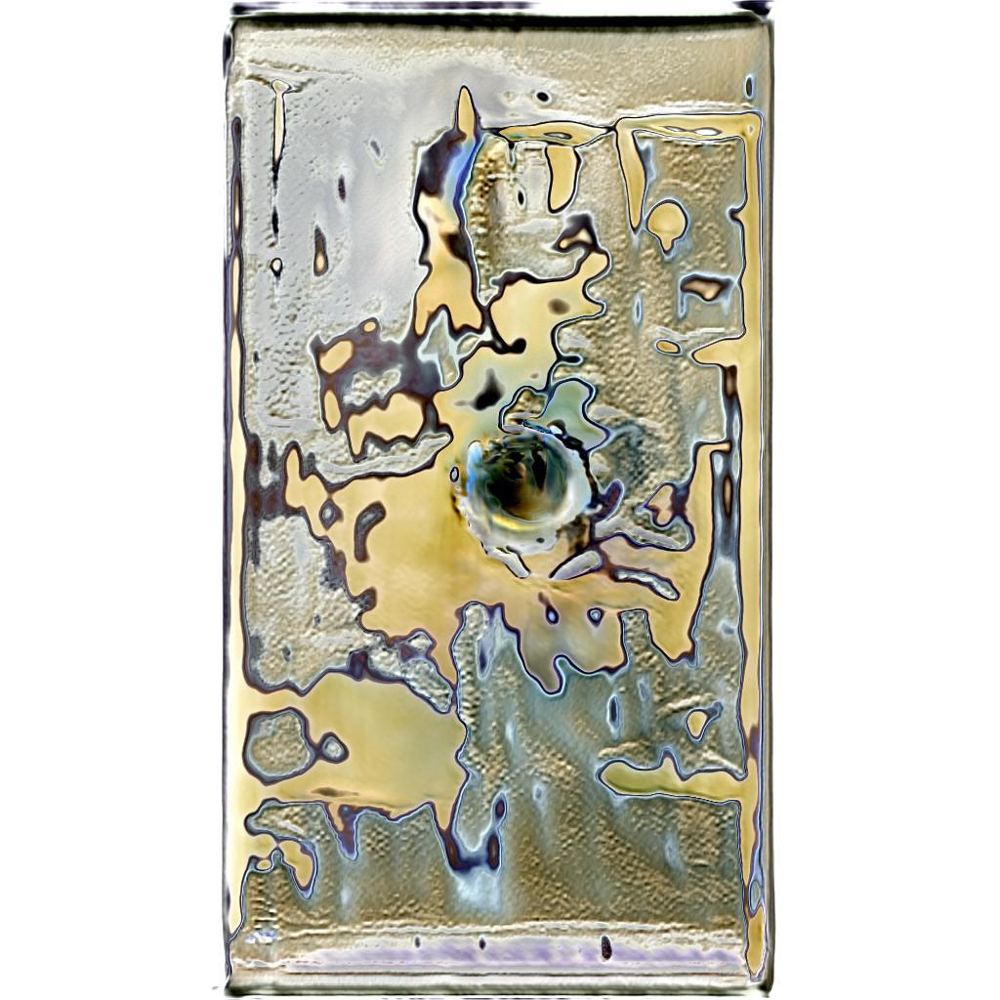

Name: The Shocked
Keyword: ['sacrifice', 'inspiration', 'debate']
Light: Allowing someone to use his or her own methods to get a job done
Shadow: Spending more time dreaming than working

img000000038.jpg


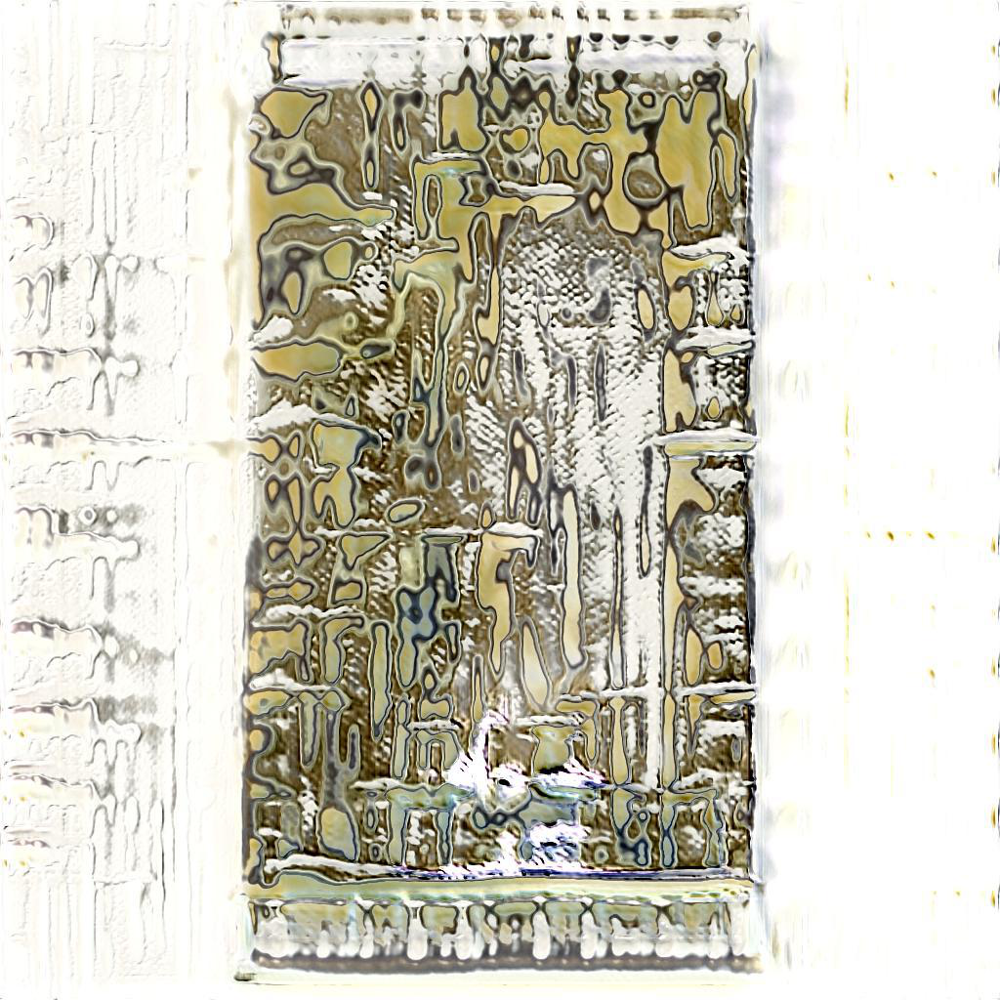

Name: The Frightened
Keyword: ['uncertainty', 'fairness', 'Enlightenment']
Light: Realizing how lucky or how blessed you are
Shadow: Stealing or lying

img000000064.jpg


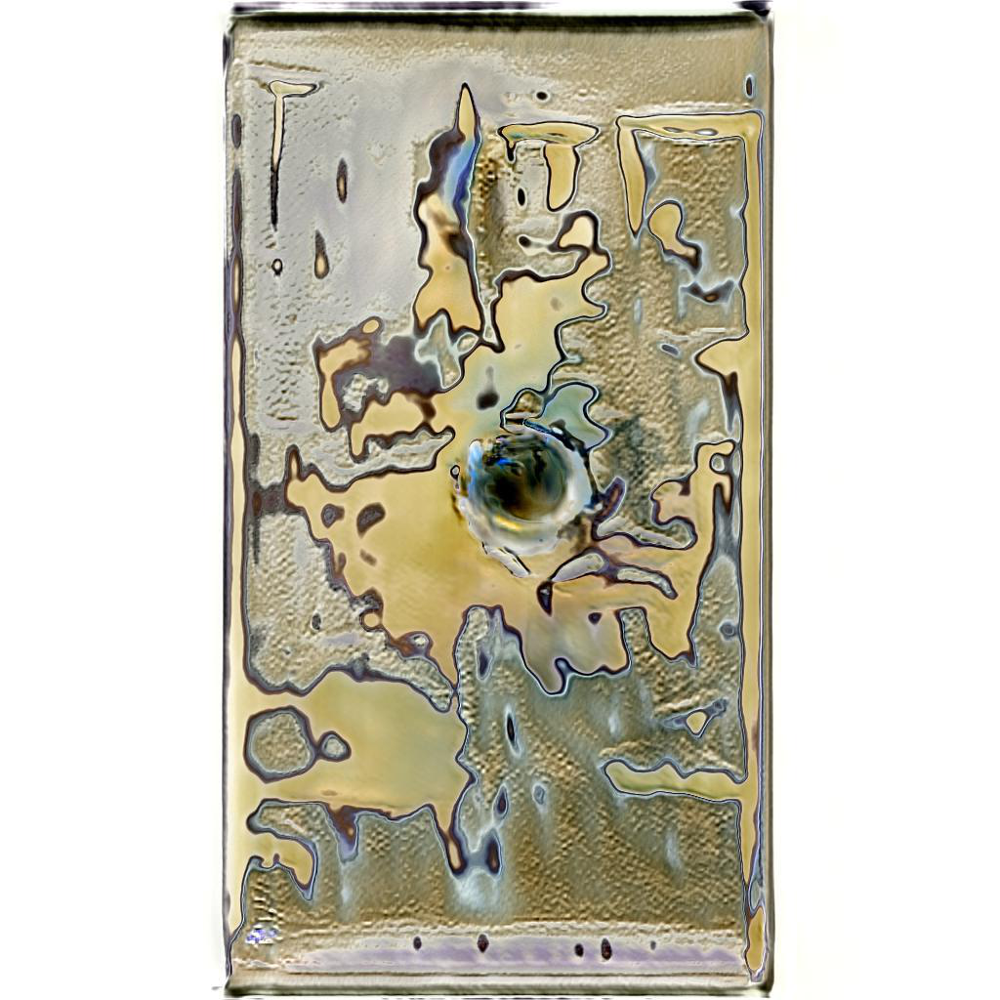

Name: The Useless
Keyword: ['Assessment', 'Capability', 'aptitude']
Light: Volunteering
Shadow: Rejecting the idea that your actions have consequences

img000000008.jpg


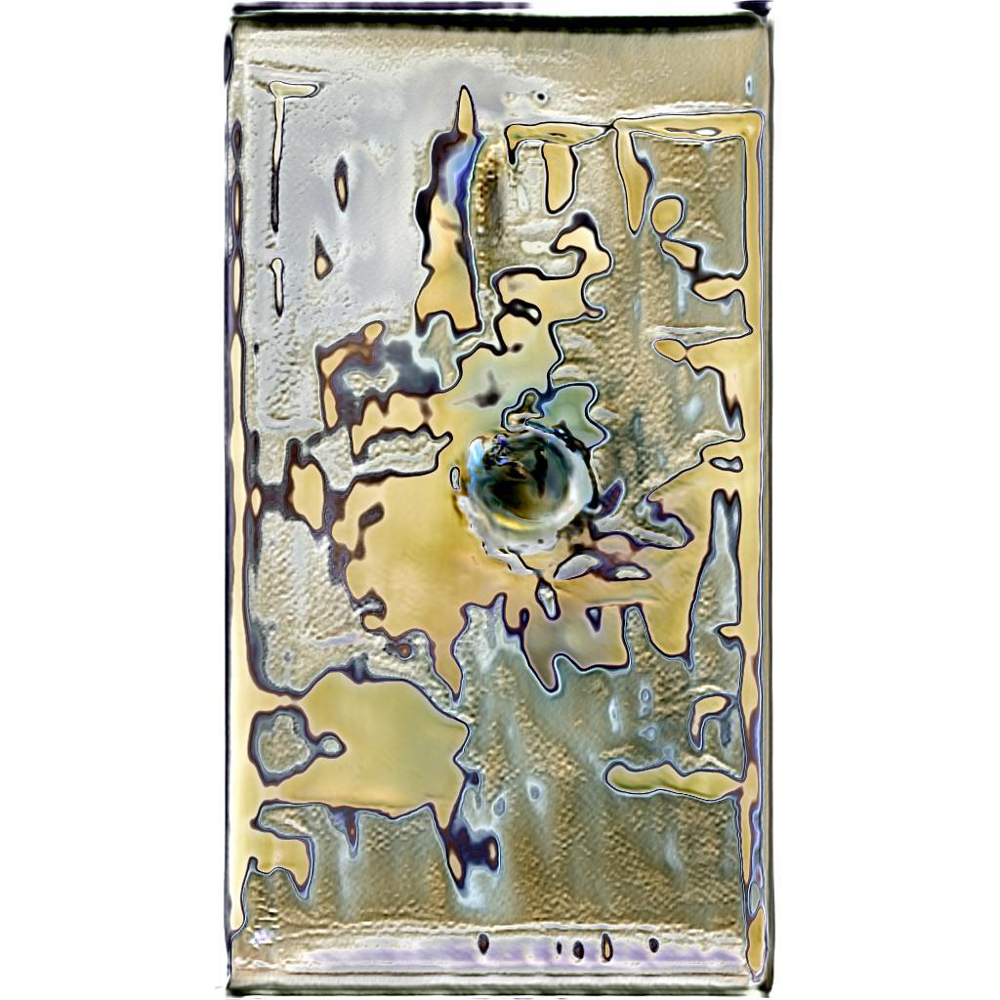

Name: The Shaken
Keyword: ['departure', 'realism', 'solitude']
Light: Resisting impulses that work against your best interests
Shadow: Offering destructive criticism

img000000074.jpg


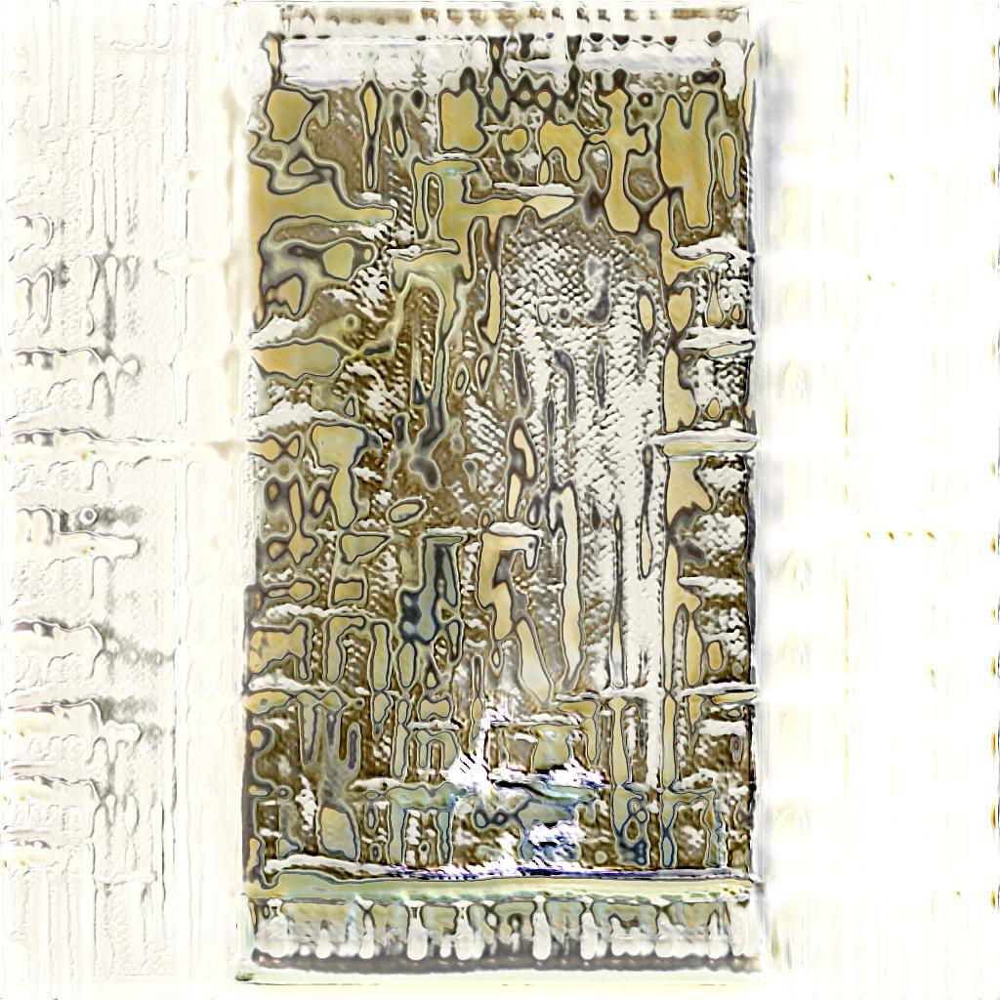

Name: The Awe
Keyword: ['ruin', 'advocacy', 'responsiveness']
Light: Maintaining your emotional stability
Shadow: Allowing a feeling of entitlement to distort your gratitude for what you're given

img000000062.jpg


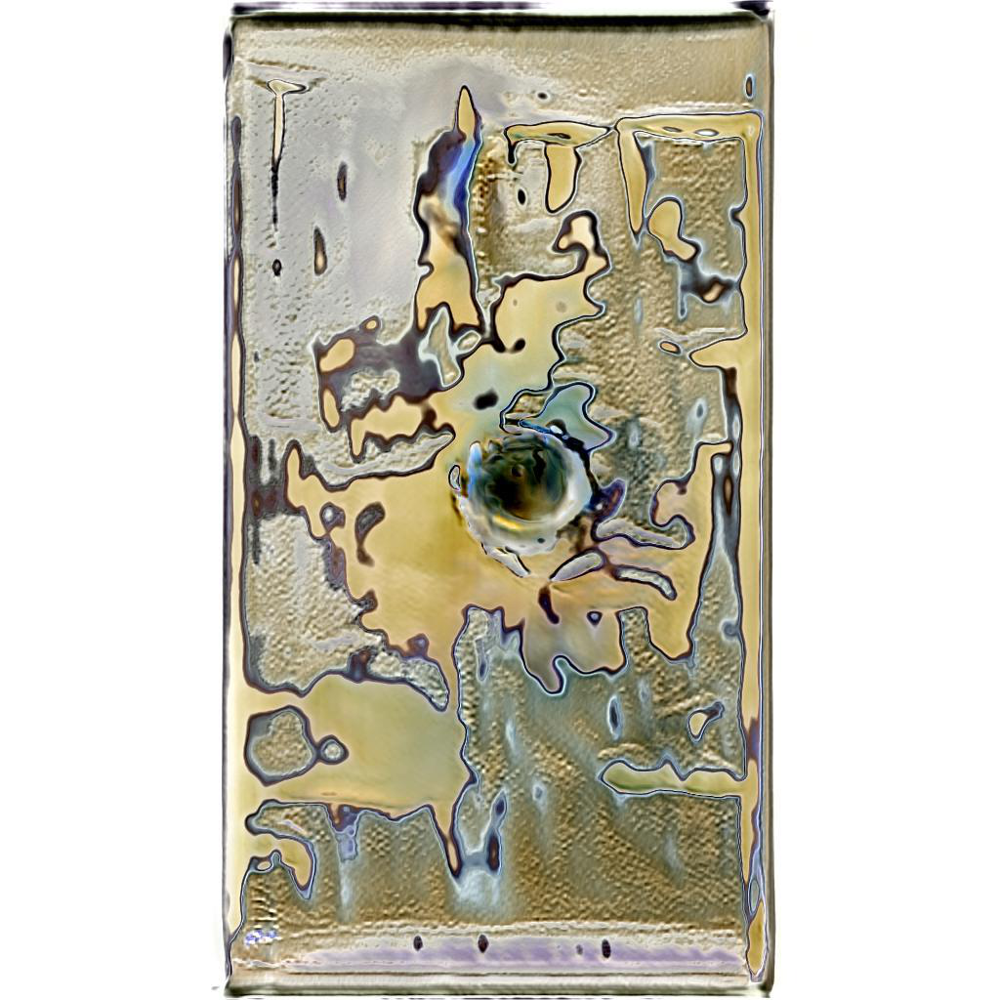

Name: The Compassion
Keyword: ['helplessness', 'boredom', 'skill']
Light: Gaining recognition for your personal genius
Shadow: Picking fights

img000000059.jpg


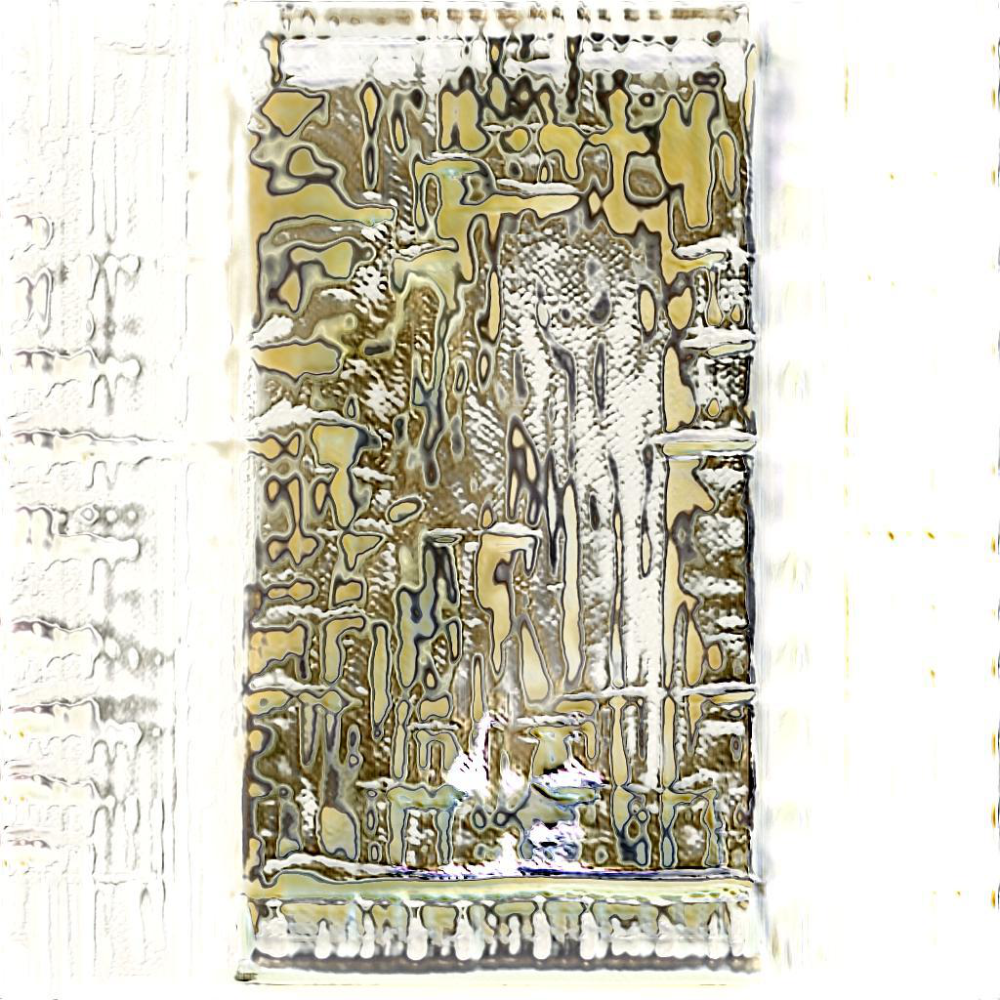

Name: The Yearning
Keyword: ['poverty', 'randomness', 'genius']
Light: Outperforming your peers
Shadow: Considering only the evidence that supports conclusions you've already drawn

img000000053.jpg


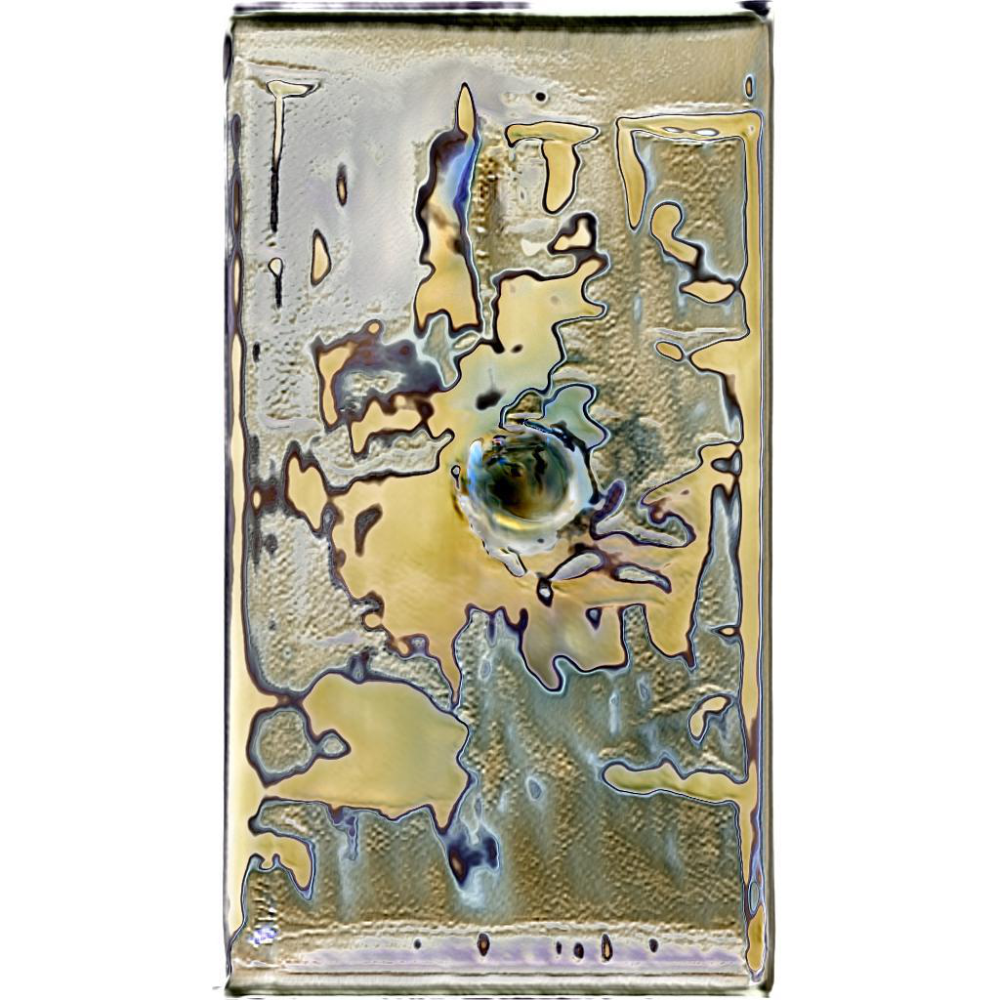

Name: The Proud
Keyword: ['individuality', 'productivity', 'Imagination']
Light: Understanding the meaning of life
Shadow: Being implacable

img000000095.jpg


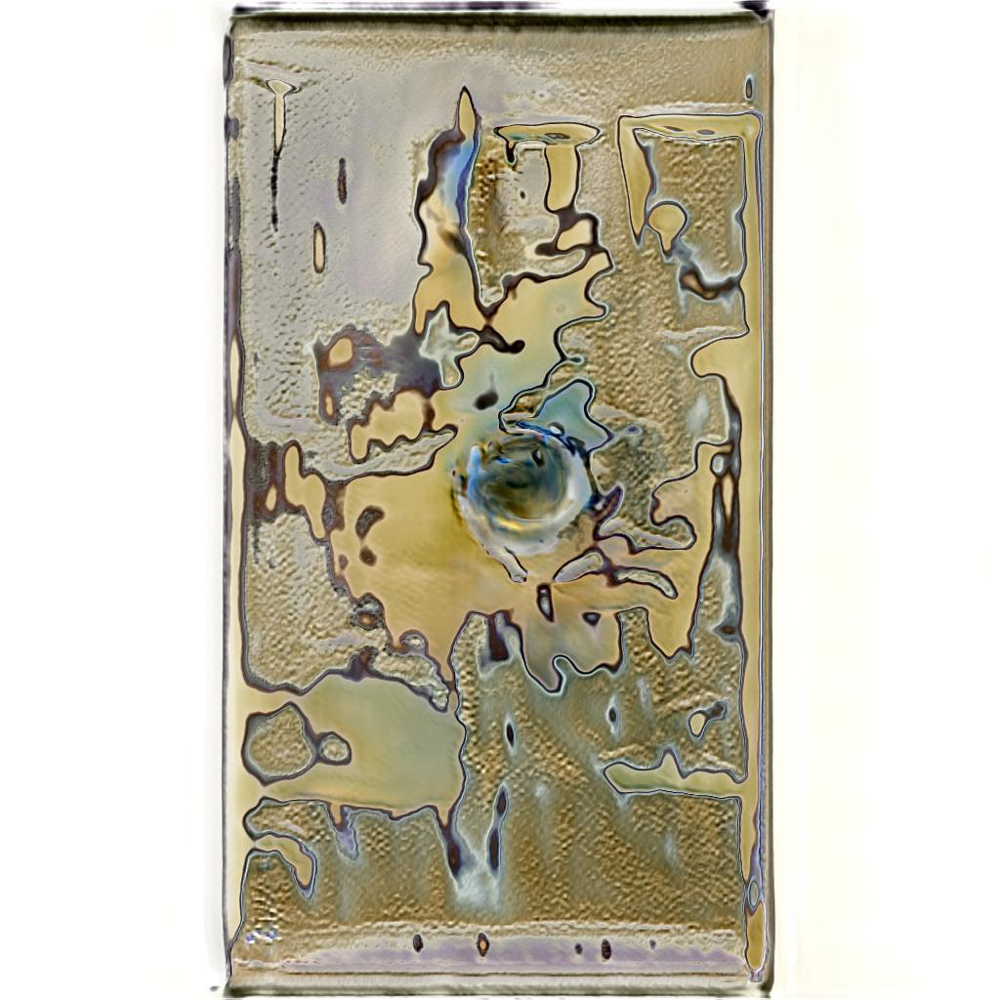

Name: The Warm
Keyword: ['destruction', 'delusion', 'repentance']
Light: Having your moment in the spotlight
Shadow: Changing course mid-stream for no good reason

img000000070.jpg


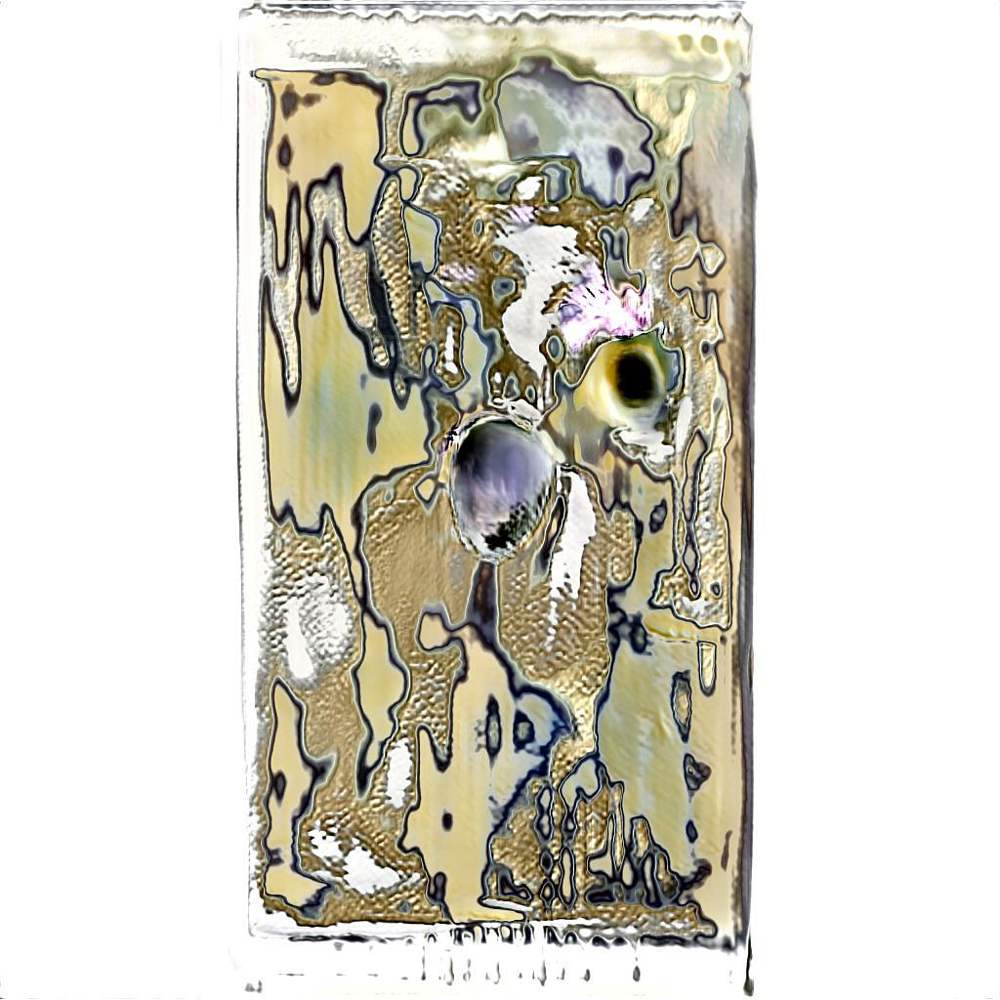

Name: The Invigorated
Keyword: ['Dishonesty', 'goals', 'generosity']
Light: Being inspired
Shadow: Allowing empathy to disable you (instead of inspire action)

img000000019.jpg


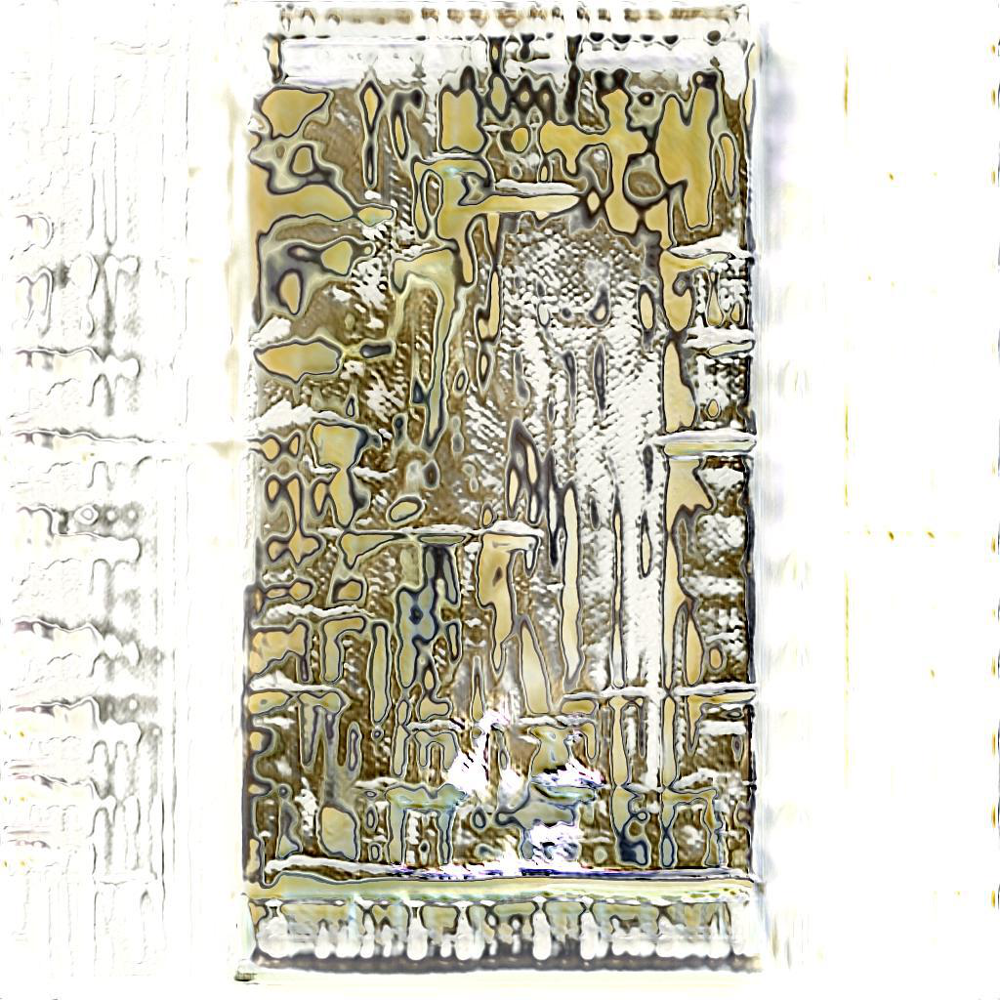

Name: The Unhappy
Keyword: ['production', 'focus', 'faith']
Light: Possessing a knack for music, math, art, or science
Shadow: Using emotional or spiritual leverage to exercise unhealthy control over others

img000000058.jpg


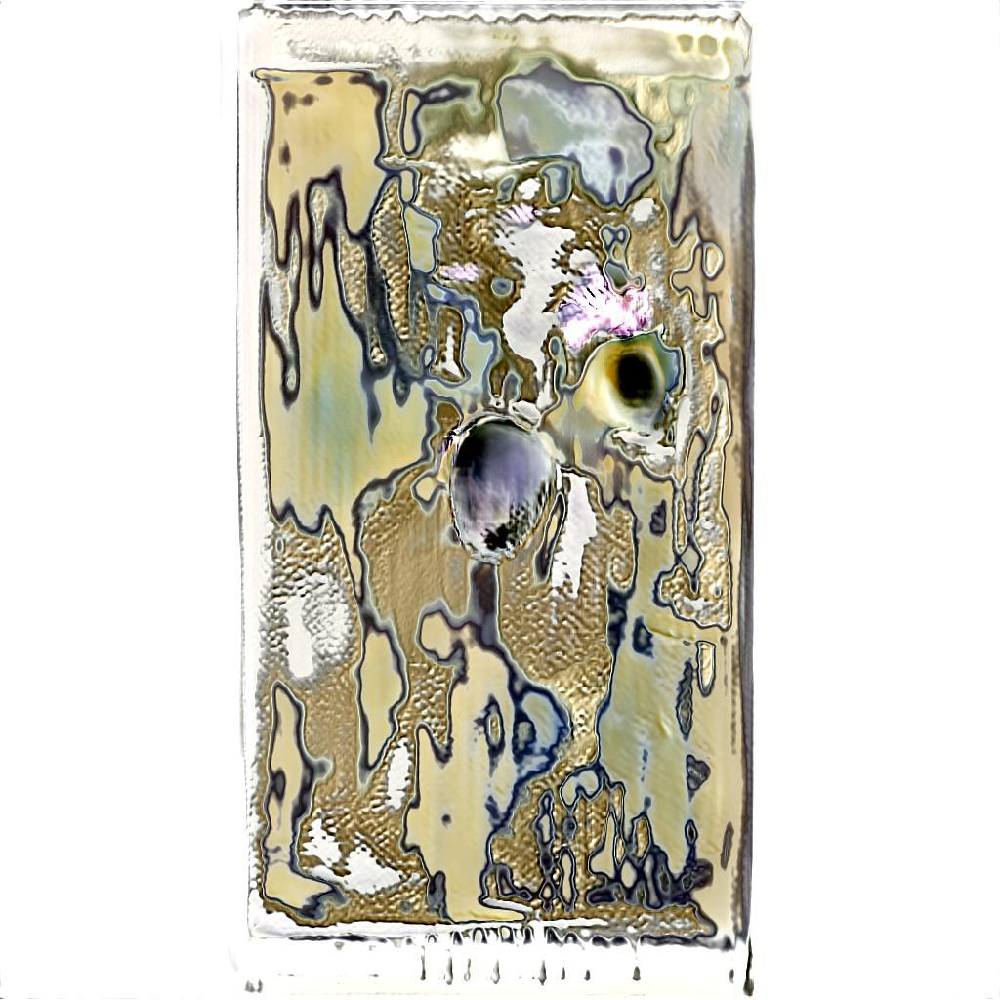

Name: The Fluttery
Keyword: ['validation', 'Creativity', 'Shadow']
Light: Healing broken ties
Shadow: Making light of the less fortunate

img000000015.jpg


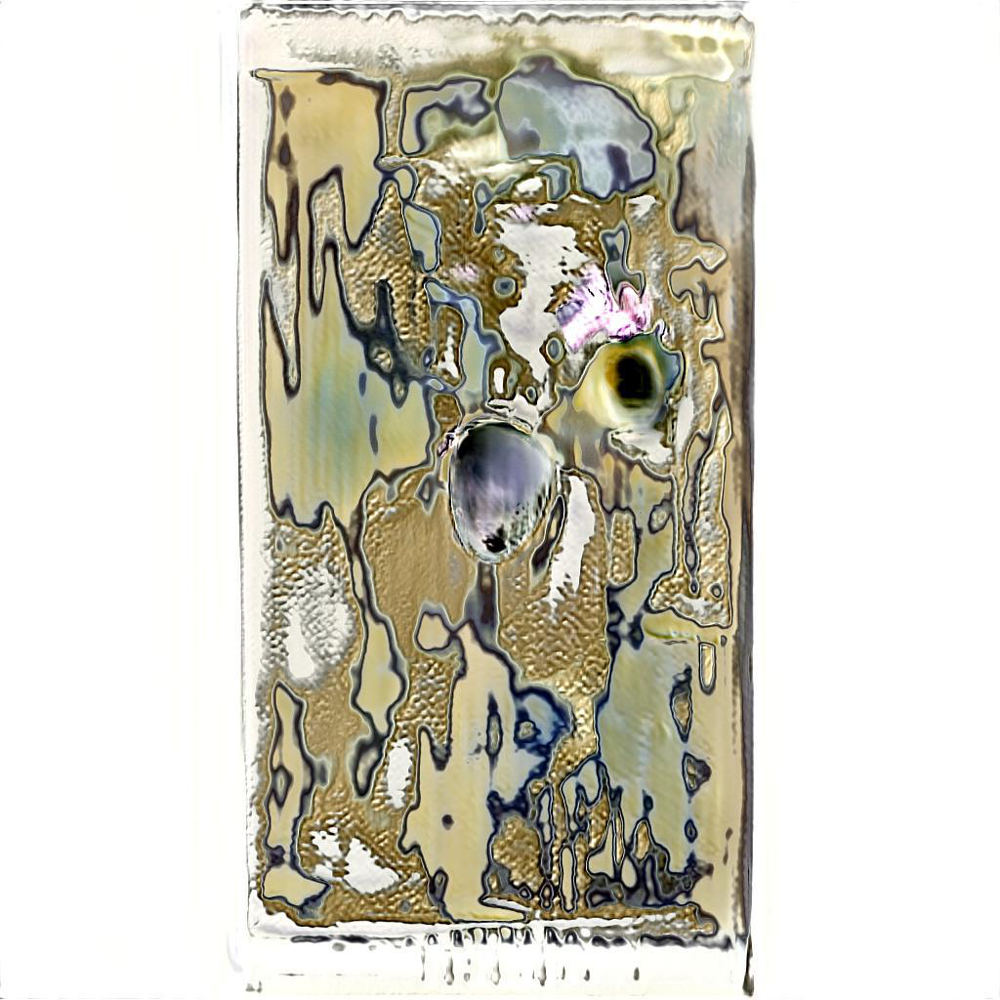

Name: The Irritated
Keyword: ['rejection', 'stability', 'resourcefulness']
Light: Refusing to make a decision without getting the facts
Shadow: Failing to be serious when required

img000000076.jpg


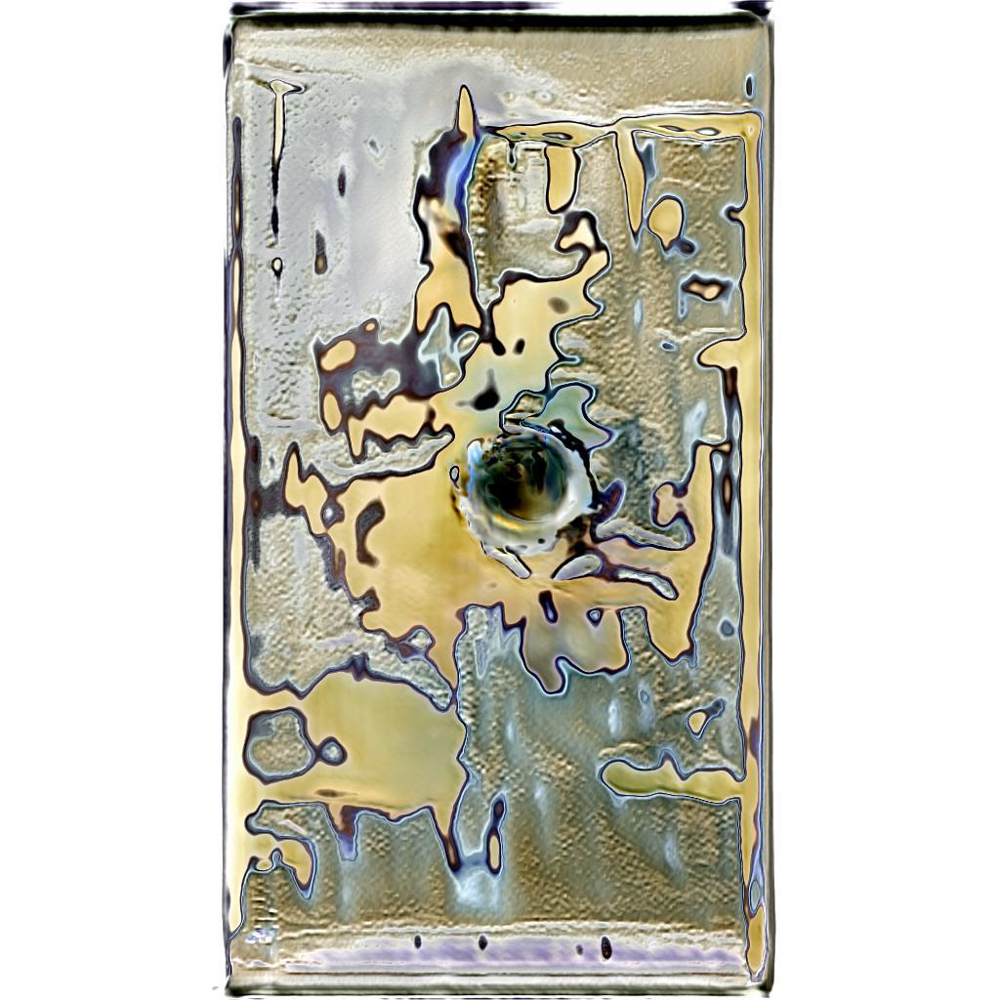

Name: The Heavy
Keyword: ['power', 'work', 'strife']
Light: Merging
Shadow: Acting in an unethical manner

img000000020.jpg


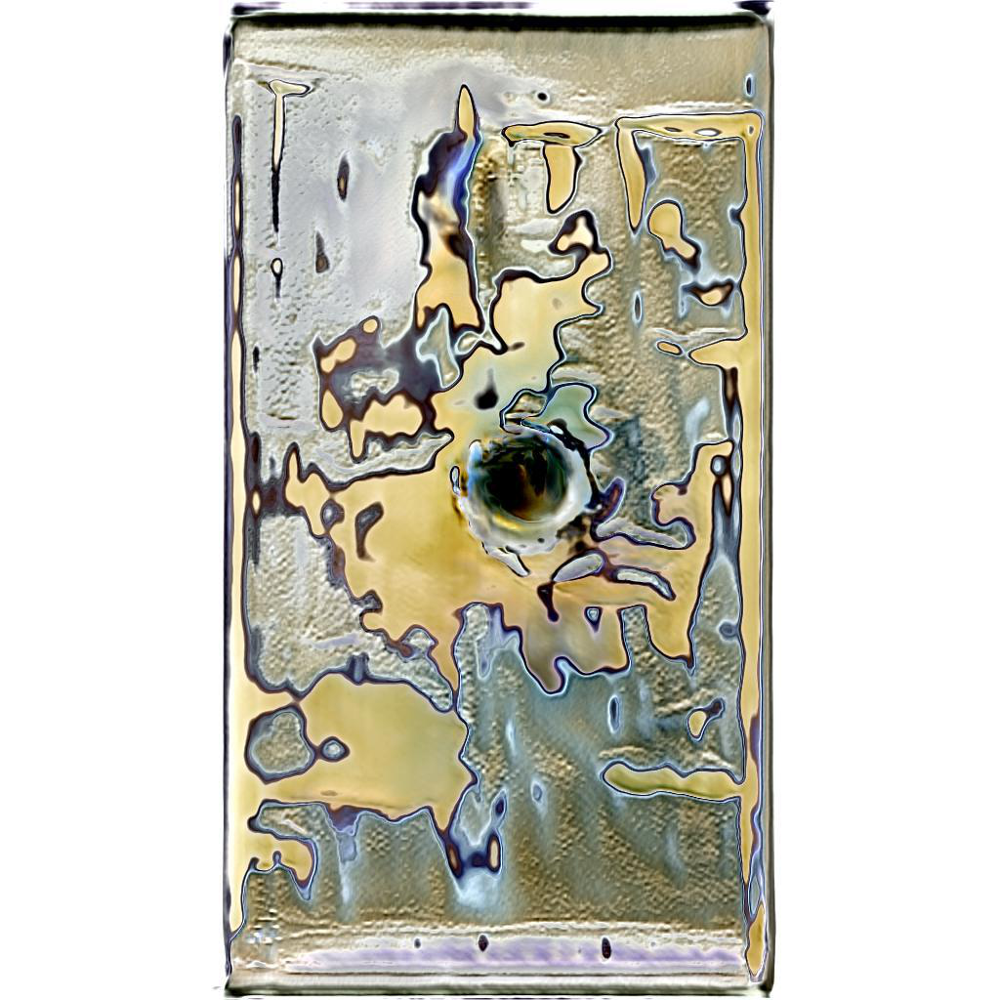

Name: The Shame
Keyword: ['enough', 'meditation', 'adolescence']
Light: Making your opinions known
Shadow: Wanting more, no matter how much you have

img000000017.jpg


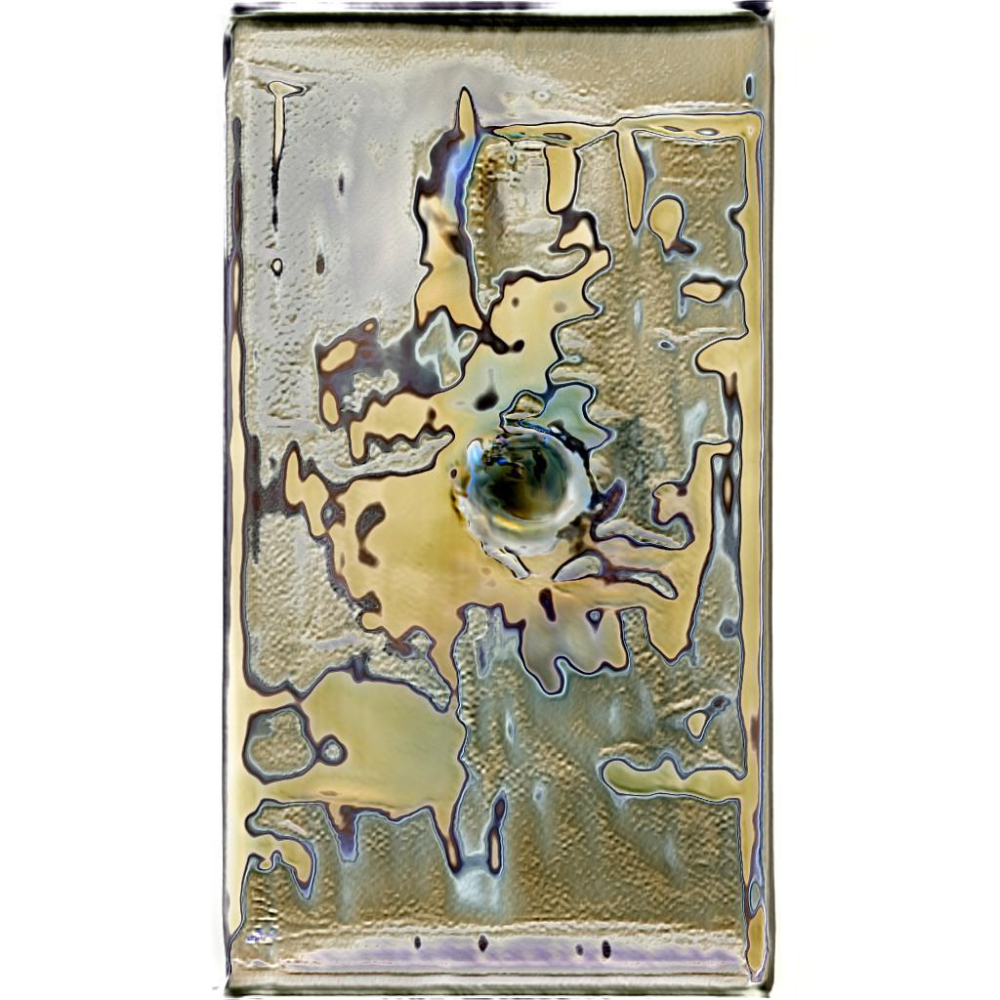

Name: The Present
Keyword: ['confidence', 'regret', 'wholeness']
Light: Getting all the facts
Shadow: Wallowing in emotionalism, sentiment, or self-pity

img000000002.jpg


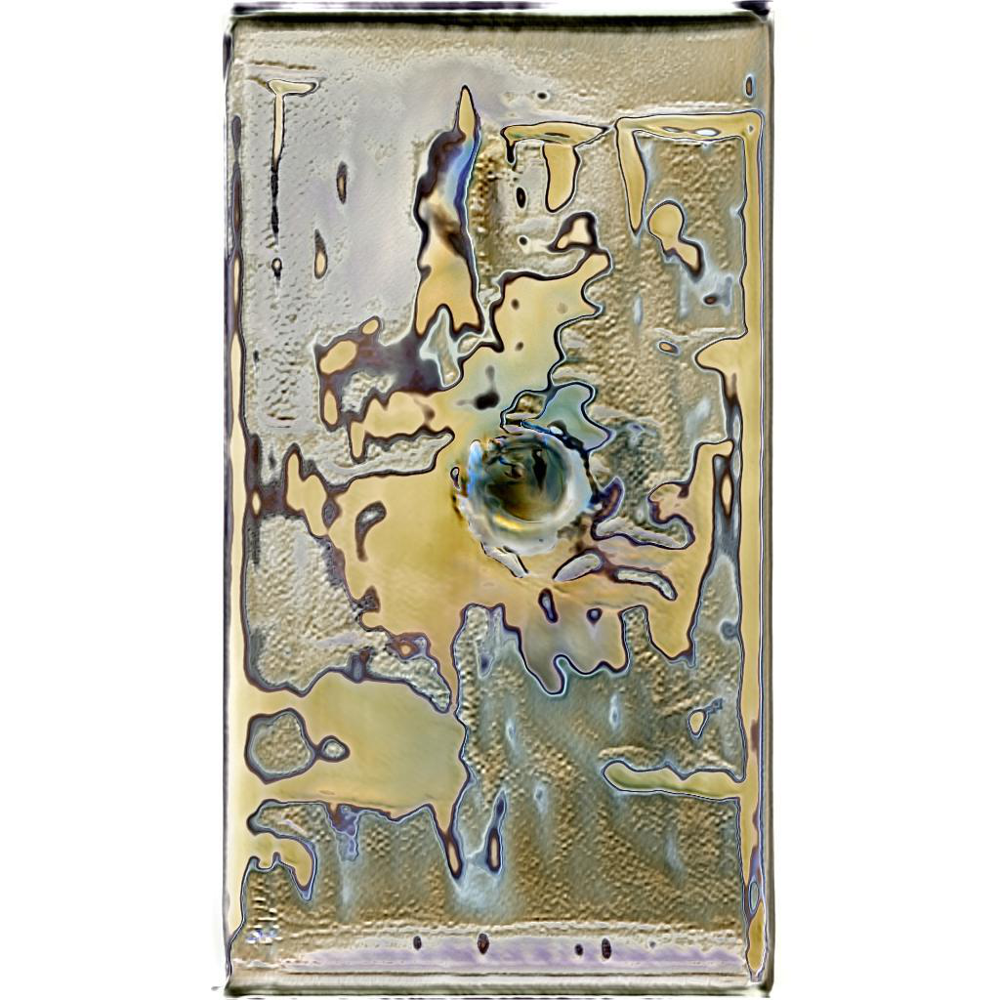

Name: The Disappointed
Keyword: ['ingratitude', 'attention', 'revelation']
Light: Performing acts of service as a way of saying, I love you
Shadow: Ruining your ability to appreciate the present by dwelling on the past

img000000091.jpg


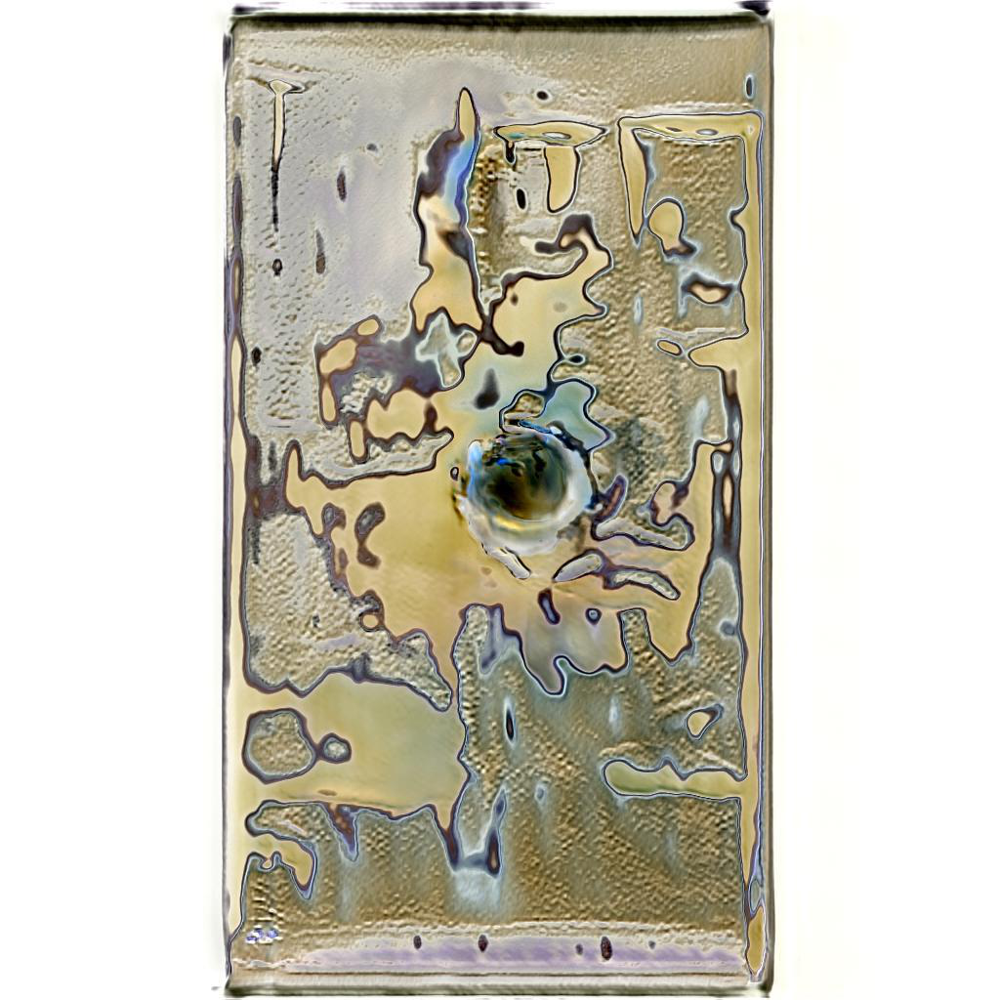

Name: The Expanded
Keyword: ['ripeness', 'ripeness', 'Fertility']
Light: Suspending disbelief
Shadow: Allowing your instincts to tame and conquer you

img000000046.jpg


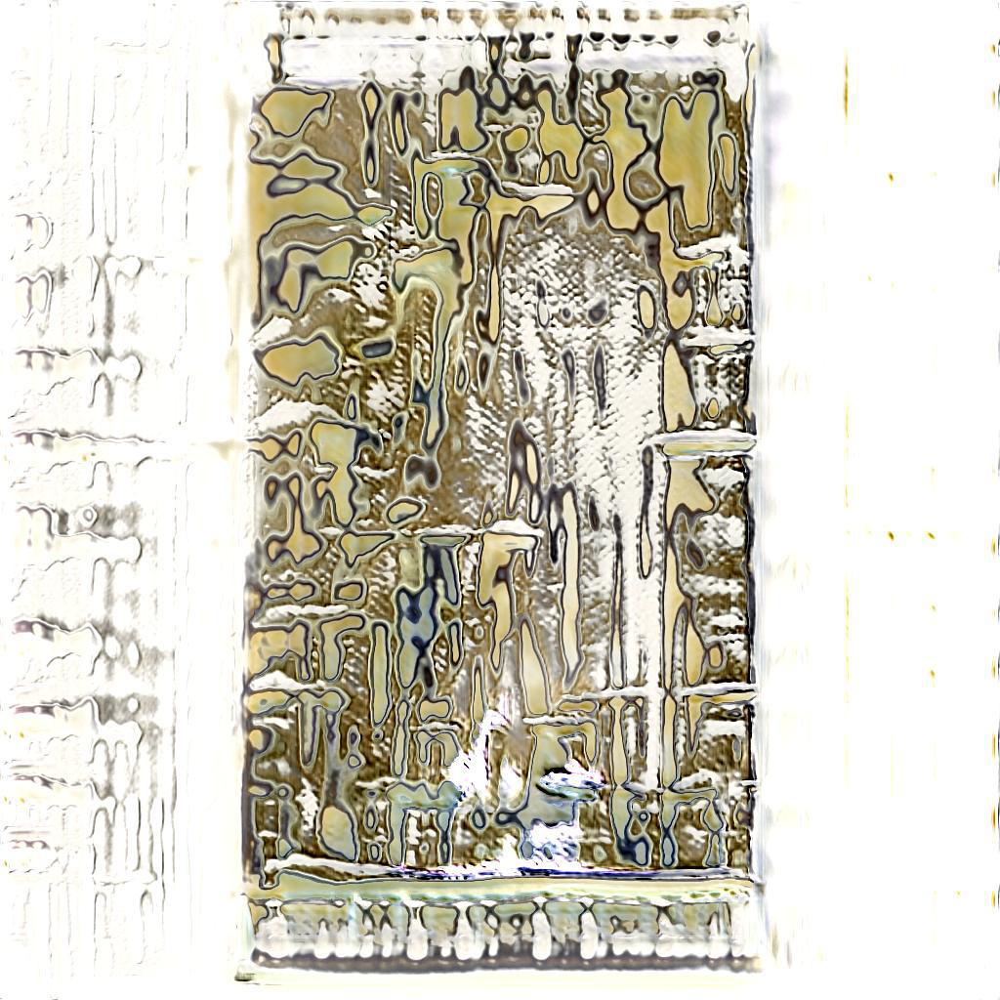

In [72]:
readings = dir + 'combined_card_readings.txt' ##New JSON text we made!

with open(readings) as f:
    new_data = json.loads(f.read())
#     pp(new_data)

## Make list of random light, shadow, keywords, and meanings
    rand_name = random.sample(new_data['name'], 22)
    rand_keywords = random.sample(new_data['keywords'], 22 * 3)
    rand_light = random.sample(new_data['meaning_light'], 22)
    rand_shadow = random.sample(new_data['meaning_shadow'], 22)
    
## Generate new 'major arcana', 22 cards

    for i in range(22):
        key_index = i*3
        print("Name: "+ rand_name[i]+"\nKeyword: "+str(rand_keywords[key_index:key_index+3])+"\nLight: "+rand_light[i]+"\nShadow: "+rand_shadow[i]+"\n")
        disp_image=Image.open(path+'/'+ rand_images[i])
        print(rand_images[i])
        display(disp_image)
        